# Multi-Cloud Workflow with Pangeo

<img src="https://cdn-images-1.medium.com/max/1200/1*uJwhZbe_Brx09yb_DKlI-g.png" width="20%" align="right">

This example demonstrates a workflow using analysis-ready data provided in two public clouds.

* [LENS](https://registry.opendata.aws/ncar-cesm-lens/) (Hosted on AWS in the us-west-2 region)
* [ERA5](https://www.ecmwf.int/en/forecasts/datasets/reanalysis-datasets/era5) (Hosted on Google Cloud Platform in multiple regions)

We'll perform a similar analysis on each of the datasets: we'll take a histogram of the total precipitation and compare the summary statistics. Notably, this computation reduces a large dataset to a small summary. The reduction can happen on a cluster in the cloud.

By placing a compute cluster in the cloud next to the data, we avoid moving large amounts of data over the public internet. The large analysis-ready data only needs to move within a cloud region: from the machines storing the data in an object-store like `S3` to the machines performing the analysis. The compute cluster reduces the large amount of data to a small histogram summary. At just a handful of KBs, the summary statistics can easily be moved back to the local client, which might be running on a laptop.

By placing compute (the Dask workers) in the same region as the dataset, we achieve the highest performance: these worker machines are physically close to the machines storing the data and have the highest bandwidth. We minimize cost by avoiding egress costs: fees charged to the data provider when data leaves a cloud region.

In [1]:
import getpass

import dask
from distributed import Client
from dask_gateway import Gateway, BasicAuth
import intake
import numpy as np
import s3fs
import xarray as xr
from xhistogram.xarray import histogram

# Create Dask Clusters

We've deployed [Dask Gateway](https://gateway.dask.org/) on two Kubernetes clusters, one in AWS and one in GCP. We'll use these to create [Dask](https://dask.org/) clusters in the same cloud region as the data. We'll connect to both of them from the same interactive notebook session.

In [3]:
password = getpass.getpass()
auth = BasicAuth("pangeo", password)

 ····


In [4]:
# Create a Dask Cluster on AWS
aws_gateway = Gateway(
    "http://a00670d37945911eab47102a1da71b1b-524946043.us-west-2.elb.amazonaws.com",
    auth=auth,
)
aws = aws_gateway.new_cluster()
aws_client = Client(aws, set_as_default=False)
aws_client

Client Scheduler: gateway://a00670d37945911eab47102a1da71b1b-524946043.us-west-2.elb.amazonaws.com:80/dask-gateway.c93dde2aba0848e091b1705b82cf66fc Dashboard: http://a00670d37945911eab47102a1da71b1b-524946043.us-west-2.elb.amazonaws.com/clusters/dask-gateway.c93dde2aba0848e091b1705b82cf66fc/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


In [5]:
# Create a Dask Cluster on GCP
gcp_gateway = Gateway(
    "http://34.72.56.89",
    auth=auth,
)
gcp = gcp_gateway.new_cluster()
gcp_client = Client(gcp, set_as_default=False)
gcp_client

Client Scheduler: gateway://34.72.56.89:80/dask-gateway.46f4bf0fb14f4798ac02203d63561e29 Dashboard: http://34.72.56.89/clusters/dask-gateway.46f4bf0fb14f4798ac02203d63561e29/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


We'll enable adaptive mode on each of the Dask clusters. Workers will be added and removed as needed by the current level of computation.

In [6]:
aws.adapt(minimum=1, maximum=200)
gcp.adapt(minimum=1, maximum=200)

# ERA5 on Google Cloud Storage

We'll use `intake` and pangeo's data catalog to discover the dataset.

In [8]:
cat = intake.open_catalog(
    "https://raw.githubusercontent.com/pangeo-data/pangeo-datastore/master/intake-catalogs/master.yaml"
)
cat

<Intake catalog: master>

The next cell loads the *metadata* as an xarray dataset. No large amount of data is read or transfered here. It  will be loaded on-demand when we ask for a concrete result later.

In [9]:
era5 = cat.atmosphere.era5_hourly_reanalysis_single_levels_sa(
    storage_options={"requester_pays": False, "token": "anon"}
).to_dask()
era5

,Array,Chunk
Bytes,1.46 TB,128.74 MB
Shape,"(350640, 721, 1440)","(31, 721, 1440)"
Count,11312 Tasks,11311 Chunks
Type,float32,numpy.ndarray


We're computing the histogram on the total precipitation for a specific time period. xarray makes selecting this subset of data quite natural. Again, we still haven't loaded the data.

In [10]:
tp = era5.tp.sel(time=slice('1990-01-01', '2005-12-31'))
tp

,Array,Chunk
Bytes,582.48 GB,128.74 MB
Shape,"(140256, 721, 1440)","(31, 721, 1440)"
Count,15838 Tasks,4526 Chunks
Type,float32,numpy.ndarray


To compare to the 6-hourly LENS dataset, we'll aggregate to 6-hourly totals.

In [11]:
# convert to 6-hourly precip totals
tp_6hr = tp.coarsen(time=6).sum()
tp_6hr

,Array,Chunk
Bytes,97.08 GB,24.92 MB
Shape,"(23376, 721, 1440)","(6, 721, 1440)"
Count,50536 Tasks,4526 Chunks
Type,float32,numpy.ndarray


We'll bin this data into the following bins.

In [12]:
tp_6hr_bins = np.concatenate([[0], np.logspace(-5,  0, 50)])
tp_6hr_bins

array([0.00000000e+00, 1.00000000e-05, 1.26485522e-05, 1.59985872e-05,
       2.02358965e-05, 2.55954792e-05, 3.23745754e-05, 4.09491506e-05,
       5.17947468e-05, 6.55128557e-05, 8.28642773e-05, 1.04811313e-04,
       1.32571137e-04, 1.67683294e-04, 2.12095089e-04, 2.68269580e-04,
       3.39322177e-04, 4.29193426e-04, 5.42867544e-04, 6.86648845e-04,
       8.68511374e-04, 1.09854114e-03, 1.38949549e-03, 1.75751062e-03,
       2.22299648e-03, 2.81176870e-03, 3.55648031e-03, 4.49843267e-03,
       5.68986603e-03, 7.19685673e-03, 9.10298178e-03, 1.15139540e-02,
       1.45634848e-02, 1.84206997e-02, 2.32995181e-02, 2.94705170e-02,
       3.72759372e-02, 4.71486636e-02, 5.96362332e-02, 7.54312006e-02,
       9.54095476e-02, 1.20679264e-01, 1.52641797e-01, 1.93069773e-01,
       2.44205309e-01, 3.08884360e-01, 3.90693994e-01, 4.94171336e-01,
       6.25055193e-01, 7.90604321e-01, 1.00000000e+00])

The next cell applies the histogram to the `longitude` dimension and takes the mean over `time`.
We're still just building up the computation here, we haven't actually loaded the data or executed it yet.

In [13]:
tp_hist = histogram(tp_6hr.rename('tp_6hr'), bins=[tp_6hr_bins], dim=['longitude']).mean(dim='time')
tp_hist.data

dask.array<mean_agg-aggregate, shape=(721, 50), dtype=float64, chunksize=(721, 50), chunktype=numpy.ndarray>

In total, we're going from the ~1.5TB raw dataset down to a small 288 kB that is the histogram summarizing the total precipitation. We've built up a large sequence of operations to do that reduction, and now it's time to actually execute it. There will be some delay between running the next cell, the scheduler receiving the task graph, and the cluster starting to process it, but work is happening in the background. After a minute or so, tasks will start appearing on the Dask dashboard.

One thing to note: we request this result with the `gcp_client`, the client for the cluster in the same cloud region as the data.

In [14]:
era5_tp_hist_ = gcp_client.compute(tp_hist, retries=5)

`gcp_tp_hist_` is a `Future` pointing to the result on the cluster. The actual computation is happening in the background, and we'll call `.result()` to get the concrete result later on.

In [15]:
era5_tp_hist_

<Future: pending, key: finalize-e3cd370f5690304ca59c076a6d4843a7>

Because the Dask cluster is in adaptive mode, this computation has kicked off a chain of events. Dask has noticed that it suddenly has many tasks to compute, so it asks for more workers. These workers are running on Virtual Machines (in Google Cloud Platform), so we've asked Google to provision many more machines. As these machines come online, our workers will come to life and the cluster will start progressing on our computation.

## LENS on AWS

This computation is very similar to the ERA5 computation. Computation-wise, the primary difference is that LENS is an ensemble. We'll histogram each member individually.

The Intake catalog created by NCAR includes many things, so we'll use `intake-esm` to search for the URL we want.

In [16]:
col = intake.open_esm_datastore(
    "https://raw.githubusercontent.com/NCAR/cesm-lens-aws/master/intake-catalogs/aws-cesm1-le.json"
)
res = col.search(frequency='hourly6-1990-2005', variable='PRECT')
res.df

,component,frequency,experiment,variable,path
0,atm,hourly6-1990-2005,20C,PRECT,s3://ncar-cesm-lens/atm/hourly6-1990-2005/cesm...


In [17]:
url = res.df.loc[0, "path"]
url

's3://ncar-cesm-lens/atm/hourly6-1990-2005/cesmLE-20C-PRECT.zarr'

We'll (lazily) load that data from S3 using s3fs, xarray, and zarr.

In [18]:
fs = s3fs.S3FileSystem(anon=True)
lens = xr.open_zarr(fs.get_mapper(url), consolidated=True)
lens

<xarray.Dataset>
Dimensions:       (ilev: 31, lat: 192, lev: 30, lon: 288, member_id: 36, nbnd: 2, slat: 191, slon: 288, time: 23360)
Coordinates:
  * ilev          (ilev) float64 2.255 5.032 10.16 18.56 ... 967.5 985.1 1e+03
  * lat           (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lev           (lev) float64 3.643 7.595 14.36 24.61 ... 957.5 976.3 992.6
  * lon           (lon) float64 0.0 1.25 2.5 3.75 ... 355.0 356.2 357.5 358.8
  * member_id     (member_id) int64 1 2 3 4 5 6 7 8 ... 29 30 31 32 33 34 35 104
  * slat          (slat) float64 -89.53 -88.59 -87.64 ... 87.64 88.59 89.53
  * slon          (slon) float64 -0.625 0.625 1.875 3.125 ... 355.6 356.9 358.1
  * time          (time) object 1990-01-01 06:00:00 ... 2006-01-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    P0            float64 ...
    PRECT         (member_id, time, lat, lon) float32 dask.array<chunksize=(2, 504, 192, 288), meta=np.ndarray>
    area          (lat, lon) float32 dask.array<chunksize=(192, 288), meta=np.ndarray>
    ch4vmr        (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    co2vmr        (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    date          (time) int32 dask.array<chunksize=(504,), meta=np.ndarray>
    date_written  (time) |S8 dask.array<chunksize=(504,), meta=np.ndarray>
    datesec       (time) int32 dask.array<chunksize=(504,), meta=np.ndarray>
    f11vmr        (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    f12vmr        (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    gw            (lat) float64 dask.array<chunksize=(192,), meta=np.ndarray>
    hyai          (ilev) float64 dask.array<chunksize=(31,), meta=np.ndarray>
    hyam          (lev) float64 dask.array<chunksize=(30,), meta=np.ndarray>
    hybi          (ilev) float64 dask.array<chunksize=(31,), meta=np.ndarray>
    hybm          (lev) float64 dask.array<chunksize=(30,), meta=np.ndarray>
    mdt           int32 ...
    n2ovmr        (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    nbdate        int32 ...
    nbsec         int32 ...
    ndbase        int32 ...
    ndcur         (time) int32 dask.array<chunksize=(504,), meta=np.ndarray>
    nlon          (lat) int32 dask.array<chunksize=(192,), meta=np.ndarray>
    nsbase        int32 ...
    nscur         (time) int32 dask.array<chunksize=(504,), meta=np.ndarray>
    nsteph        (time) int32 dask.array<chunksize=(504,), meta=np.ndarray>
    ntrk          int32 ...
    ntrm          int32 ...
    ntrn          int32 ...
    sol_tsi       (time) float64 dask.array<chunksize=(504,), meta=np.ndarray>
    time_bnds     (time, nbnd) object dask.array<chunksize=(11680, 2), meta=np.ndarray>
    time_written  (time) |S8 dask.array<chunksize=(504,), meta=np.ndarray>
    w_stag        (slat) float64 dask.array<chunksize=(191,), meta=np.ndarray>
    wnummax       (lat) int32 dask.array<chunksize=(192,), meta=np.ndarray>
Attributes:
    Conventions:               CF-1.0
    NCO:                       4.3.4
    Version:                   $Name$
    history:                   2019-08-01 00:15:18.487461 xarray.open_dataset...
    important_note:            This data is part of the project 'Blind Evalua...
    nco_openmp_thread_number:  1
    revision_Id:               $Id$
    source:                    CAM
    title:                     UNSET

In [19]:
hour = 60*60

precip_in_m = lens.PRECT * (6 * hour)
precip_in_m

,Array,Chunk
Bytes,186.01 GB,222.95 MB
Shape,"(36, 23360, 192, 288)","(2, 504, 192, 288)"
Count,1693 Tasks,846 Chunks
Type,float32,numpy.ndarray


We'll get a histogram for each member individually.

In [20]:
histograms = [
    histogram(
        precip_in_m.sel(member_id=member_id).rename("tp_6hr"),
        bins=[tp_6hr_bins], dim=["lon"]
    ).mean(dim=('time'))
    for member_id in precip_in_m.member_id.values
]

In [21]:
histograms[0].data

dask.array<mean_agg-aggregate, shape=(192, 50), dtype=float64, chunksize=(192, 50), chunktype=numpy.ndarray>

Note that we're using the `aws_client`, because LENS is stored in an AWS region.

In [22]:
histograms = aws_client.compute(histograms)

## Compare results


We'll collect this list of histograms for LENS (one per member) and plot each

In [23]:
histograms2 = [x.result() for x in histograms]
histograms_ = xr.concat(histograms2, "member_id")
histograms_

<xarray.DataArray 'histogram_tp_6hr' (member_id: 36, lat: 192, tp_6hr_bin: 50)>
array([[[151.83921233,   8.04657534,   8.10954623, ...,   0.        ,
           0.        ,   0.        ],
        [150.74691781,   7.58129281,   8.16643836, ...,   0.        ,
           0.        ,   0.        ],
        [152.11117295,   7.7072774 ,   8.13685788, ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 74.41125856,  10.44683219,  11.3192637 , ...,   0.        ,
           0.        ,   0.        ],
        [ 74.93154966,  10.15166952,  10.83313356, ...,   0.        ,
           0.        ,   0.        ],
        [ 76.93030822,  10.87786815,  11.3796661 , ...,   0.        ,
           0.        ,   0.        ]],

       [[151.34306507,   7.33407534,   8.52119007, ...,   0.        ,
           0.        ,   0.        ],
        [151.07880993,   7.3838613 ,   7.99379281, ...,   0.        ,
           0.        ,   0.        ],
        [152.96883562,   7.5755137 ,   8.03895548, ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 77.32422945,  11.07821062,  12.12898116, ...,   0.        ,
           0.        ,   0.        ],
        [ 77.10222603,  11.07106164,  12.15642123, ...,   0.        ,
           0.        ,   0.        ],
        [ 78.98548801,  11.78223459,  12.12315925, ...,   0.        ,
           0.        ,   0.        ]],

       [[153.10321062,   7.91870719,   8.13398973, ...,   0.        ,
           0.        ,   0.        ],
        [152.13193493,   7.5145976 ,   8.01434075, ...,   0.        ,
           0.        ,   0.        ],
        [154.66896404,   7.70539384,   8.13313356, ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 75.60059932,  10.66575342,  11.38938356, ...,   0.        ,
           0.        ,   0.        ],
        [ 74.57962329,  10.37803938,  11.19580479, ...,   0.        ,
           0.        ,   0.        ],
        [ 75.2390411 ,  11.36057363,  11.64400685, ...,   0.        ,
           0.        ,   0.        ]],

       ...,

       [[144.62251712,   7.13026541,   7.40663527, ...,   0.        ,
           0.        ,   0.        ],
        [144.25706336,   7.26673801,   7.88741438, ...,   0.        ,
           0.        ,   0.        ],
        [147.07666952,   7.47071918,   7.96875   , ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 83.79888699,  10.38535959,  11.06374144, ...,   0.        ,
           0.        ,   0.        ],
        [ 84.19263699,   9.83964041,  10.62367295, ...,   0.        ,
           0.        ,   0.        ],
        [ 86.06618151,  10.36142979,  11.72333048, ...,   0.        ,
           0.        ,   0.        ]],

       [[150.65244007,   7.32440068,   7.85235445, ...,   0.        ,
           0.        ,   0.        ],
        [150.28172089,   7.54773116,   7.96468322, ...,   0.        ,
           0.        ,   0.        ],
        [152.3822774 ,   7.67046233,   8.16579623, ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 74.47851027,  10.78514555,  11.70329623, ...,   0.        ,
           0.        ,   0.        ],
        [ 73.97410103,  10.56378425,  11.47645548, ...,   0.        ,
           0.        ,   0.        ],
        [ 75.5479024 ,  11.3979024 ,  11.89563356, ...,   0.        ,
           0.        ,   0.        ]],

       [[147.57958048,   7.36130137,   7.25475171, ...,   0.        ,
           0.        ,   0.        ],
        [147.14901541,   7.57975171,   8.04447774, ...,   0.        ,
           0.        ,   0.        ],
        [149.42538527,   7.53510274,   8.03694349, ...,   0.        ,
           0.        ,   0.        ],
        ...,
        [ 76.14777397,  11.46690925,  12.19781678, ...,   0.        ,
           0.        ,   0.        ],
        [ 75.81361301,  11.28244863,  11.95800514, ...,   0.        ,
           0.        ,   0.        ],
        [ 78.14678938,  11.58664384,  1

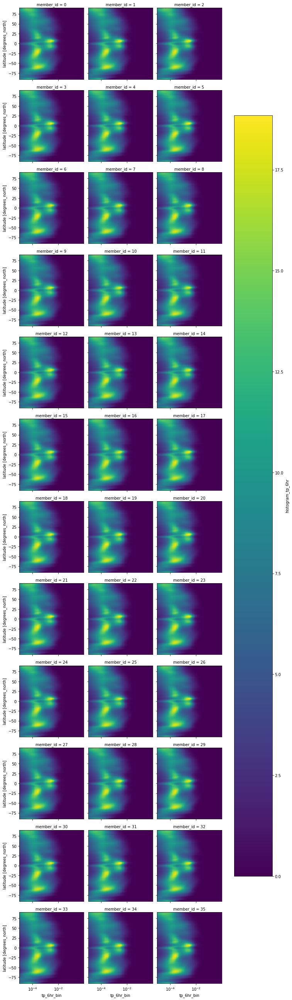

In [24]:
histograms_.isel(tp_6hr_bin=slice(1, None)).plot(xscale="log", col="member_id", col_wrap=3);

And the ERA5 histogram.

In [25]:
era5_tp_hist_ = era5_tp_hist_.result()

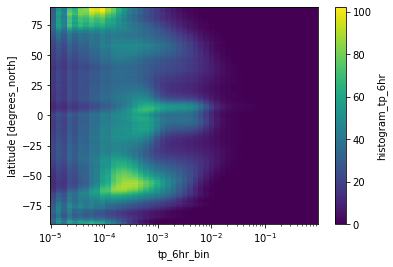

In [26]:
era5_tp_hist_[: ,1:].plot(xscale='log');

# cleanup

In [27]:
aws_client.close()
aws.close()

gcp_client.close()
gcp.close()

## Behind the Scenes

We deployed some infrastructure to make this notebook runnable. In line with one of Pangeo's guiding principles, each of these technologies has an [open architechture](https://medium.com/pangeo/closed-platforms-vs-open-architectures-for-cloud-native-earth-system-analytics-1ad88708ebb6).

![](multi-cloud.png)

* **Jupyterlab** provides a user interface for interactive computing
* **Intake, gcsfs, s3fs** provide catalogs for data discover and libraries for loading that data
* **xarray** provides high-level APIs and high-performance data structures for working with this data
* **Dask** provides scalable, distributed computation for analyzing these large datasets
* **Dask-Gatway** provides centralized, secure access to Dask Clusters. These clusters were deployed using [helm](https://helm.sh/) on two Kubernetes clusters.
* **Kubernetes** provides the container orchestration for deploying the Dask Clusters. We created kubernetes clusters in AWS's `us-west-2` and GCP's `us-central1` regsions.
* **Terraform** provides the tools for provisioning the cloud resources needed for the clusters.

All of the resources for this demo are available at https://github.com/pangeo-data/multicloud-demo.